In [317]:
import requests
import pandas as pd
import requests
import pandas as pd
from collections import defaultdict
import re
import requests
import numpy as np
import pandas as pd
import re
from collections import defaultdict
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_iris
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree 
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [318]:
from networkx.drawing.nx_agraph import graphviz_layout

In [319]:
url = "https://www.datos.gov.co/resource/v98q-23dp.json?$query=SELECT%0A%20%20%60titulo%60%2C%0A%20%20%60descripcion%60%2C%0A%20%20%60url_lista_de_reproduccion%60%2C%0A%20%20%60plataforma%60"

# Realizar la solicitud GET al servicio
response = requests.get(url)

# Verificar si la solicitud fue exitosa (código de estado 200)
if response.status_code == 200:
    # Obtener los datos en formato JSON
    data = response.json()

    # Crear un DataFrame con los datos
    df = pd.DataFrame(data)

    # Obtener todos los títulos en una lista
    titulos = df['titulo'].tolist()
    # Diccionario para almacenar las palabras y sus repeticiones
    palabras_dict = defaultdict(int)
    # Recorrer los títulos y contar las palabras
    for titulo in titulos:
        # Convertir el texto a minúsculas y remover tildes
        titulo = titulo.lower()
        titulo = re.sub('[áäâà]', 'a', titulo)
        titulo = re.sub('[éëêè]', 'e', titulo)
        titulo = re.sub('[íïîì]', 'i', titulo)
        titulo = re.sub('[óöôò]', 'o', titulo)
        titulo = re.sub('[úüûù]', 'u', titulo)
        titulo = re.sub('[^a-z]', ' ', titulo)  
        titulo = re.sub('\s+', ' ', titulo)
        
        # Dividir el texto en palabras
        palabras = titulo.split()

        
        # Contar las repeticiones de cada palabra
        for palabra in palabras:
            if palabra != "-":
                palabras_dict[palabra] += 1
    # Calcular el número total de palabras únicas
    num_palabras_unicas = len(palabras_dict)

    # Calcular el número total de palabras en el dataset
    num_palabras_totales = sum(palabras_dict.values())

    # Imprimir los resultados
    print("Número total de palabras únicas:", num_palabras_unicas)
    print("Número total de palabras en el dataset:", num_palabras_totales)
else:
    print("Error en la solicitud:", response.status_code)

Número total de palabras únicas: 1874
Número total de palabras en el dataset: 7154


In [320]:
df

,titulo,descripcion,url_lista_de_reproduccion,plataforma
0,Urbílogo - Bogotá dominguera,Entretenimiento,https://www.youtube.com/watch?v=2SNMqfo8COo,Señal Colombia
1,Historias en bici - Sibaté pedalea su pasado,Deportes,https://www.youtube.com/watch?v=ooEcRqrIyF8,Señal Deportes
2,Today in replay 18 de febrero,Deportes,https://www.youtube.com/watch?v=jzNsXnuQpDU,Señal Deportes
3,"Documentales: 'Camilo, el cura guerrillero' - ...",Película y Animación,https://www.youtube.com/watch?v=2vFrMJlP9OY,Señal Colombia
4,En cine nos vemos - Cuchillo de palo - Renate ...,Película y Animación,https://www.youtube.com/watch?v=VCtHtjphNOY,Señal Colombia
...,...,...,...,...
995,Para ver TV - Deporte,Entretenimiento,https://www.youtube.com/watch?v=yRW4EdsB8F0,Señal Colombia
996,Franja Retro - NN,Deportes,https://www.youtube.com/watch?v=I_0avV2Ql2o,Señal Colombia
997,Todo lo que vemos - 118 - Televidentes - Frank...,Educación,https://www.youtube.com/watch?v=k8aG5jcPp7w,Señal Colombia
998,sillón justicia música e identidad,Entretenimiento,https://www.youtube.com/watch?v=J0RMXGpu_BU,Señal Colombia


In [321]:
print(palabras_dict)
print(len(palabras_dict))

defaultdict(<class 'int'>, {'urbilogo': 3, 'bogota': 5, 'dominguera': 1, 'historias': 8, 'en': 137, 'bici': 9, 'sibate': 1, 'pedalea': 1, 'su': 10, 'pasado': 1, 'today': 39, 'in': 39, 'replay': 39, 'de': 379, 'febrero': 14, 'documentales': 1, 'camilo': 2, 'el': 105, 'cura': 1, 'guerrillero': 1, 'hoy': 9, 'martes': 6, 'mayo': 11, 'p': 40, 'm': 43, 'se': 95, 'alparapensar': 7, 'cine': 52, 'nos': 41, 'vemos': 261, 'cuchillo': 1, 'palo': 1, 'renate': 1, 'costa': 1, 'los': 95, 'pepa': 20, 'clip': 25, 'mascara': 1, 'carnaval': 2, 'saludo': 26, 'miguel': 5, 'angel': 2, 'lopez': 8, 'todo': 248, 'lo': 259, 'que': 268, 'televidente': 73, 'oscar': 8, 'augusto': 1, 'ferreira': 1, 'nairo': 6, 'quintana': 3, 'ya': 6, 'esta': 6, 'viajando': 1, 'a': 125, 'francia': 14, 'sillon': 16, 'hip': 1, 'hop': 1, 'concurso': 2, 'nacional': 3, 'bandas': 2, 'paipa': 2, 'boyaca': 2, 'desfile': 1, 'completo': 45, 'tour': 12, 'con': 32, 'sub': 23, 'originalidad': 1, 'pedaleopor': 22, 'ariel': 2, 'molina': 3, 'envia':

In [322]:
print(palabras_dict)
lista = list(palabras_dict.keys())
dic = { v:k for k,v in enumerate(lista)}
dic['bogota']
matriz=[]
for a in titulos:
    palabras1 = [0] *  (len(palabras_dict))
    a = a.lower()
    a = re.sub('[áäâà]', 'a', a)
    a = re.sub('[éëêè]', 'e', a)
    a = re.sub('[íïîì]', 'i', a)
    a = re.sub('[óöôò]', 'o', a)
    a = re.sub('[úüûù]', 'u', a)
    a = re.sub('[^a-z]', ' ', a)  # Eliminar caracteres no alfabéticos
    a = re.sub('\s+', ' ', a)
    palabras2 = a.split()
    for i in palabras2:
        print(i)
        if i in dic:
            palabras1[dic[i]] = palabras1[dic[i]]  + 1
    o=0
    for  o in range(len(palabras1)):
        if palabras1[o] != 0:
            palabras1[o]= palabras1[o]/sum(palabras1)
    matriz.append(palabras1)
    print(dic)
    print(len(dic))



defaultdict(<class 'int'>, {'urbilogo': 3, 'bogota': 5, 'dominguera': 1, 'historias': 8, 'en': 137, 'bici': 9, 'sibate': 1, 'pedalea': 1, 'su': 10, 'pasado': 1, 'today': 39, 'in': 39, 'replay': 39, 'de': 379, 'febrero': 14, 'documentales': 1, 'camilo': 2, 'el': 105, 'cura': 1, 'guerrillero': 1, 'hoy': 9, 'martes': 6, 'mayo': 11, 'p': 40, 'm': 43, 'se': 95, 'alparapensar': 7, 'cine': 52, 'nos': 41, 'vemos': 261, 'cuchillo': 1, 'palo': 1, 'renate': 1, 'costa': 1, 'los': 95, 'pepa': 20, 'clip': 25, 'mascara': 1, 'carnaval': 2, 'saludo': 26, 'miguel': 5, 'angel': 2, 'lopez': 8, 'todo': 248, 'lo': 259, 'que': 268, 'televidente': 73, 'oscar': 8, 'augusto': 1, 'ferreira': 1, 'nairo': 6, 'quintana': 3, 'ya': 6, 'esta': 6, 'viajando': 1, 'a': 125, 'francia': 14, 'sillon': 16, 'hip': 1, 'hop': 1, 'concurso': 2, 'nacional': 3, 'bandas': 2, 'paipa': 2, 'boyaca': 2, 'desfile': 1, 'completo': 45, 'tour': 12, 'con': 32, 'sub': 23, 'originalidad': 1, 'pedaleopor': 22, 'ariel': 2, 'molina': 3, 'envia':

In [323]:
print(matriz[0])
print(len(matriz[0]))
print(matriz[1])
print(len(matriz[1]))
print(matriz[2])
print(len(matriz[2]))
print(len(titulos))
print(len(matriz))

[0.3333333333333333, 0.4285714285714286, 0.5675675675675675, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [324]:
from math import log
IDf = [0] * (len(palabras_dict))
dicAux = defaultdict(int)
for titulo1 in titulos:
    aux = defaultdict(int)
    titulo1 = titulo1.lower()
    titulo1 = re.sub('[áäâà]', 'a', titulo1)
    titulo1 = re.sub('[éëêè]', 'e', titulo1)
    titulo1 = re.sub('[íïîì]', 'i', titulo1)
    titulo1 = re.sub('[óöôò]', 'o', titulo1)
    titulo1 = re.sub('[úüûù]', 'u', titulo1)
    titulo1 = re.sub('[^a-z]', ' ', titulo1)  # Eliminar caracteres no alfabéticos
    titulo1 = re.sub('\s+', ' ', titulo1)
    palabras4 = titulo1.split()
    aux2 = 0
    palabrasUnicas =[]
    for g in palabras4:
        if g != "-":
            if g not in aux:
                palabrasUnicas.append(g)
            aux[g] = aux2
            dicAux[g] = aux2
            aux2 = aux2 +1
    for palabraAgre in  palabrasUnicas:
        if palabraAgre  in dic:
            IDf[dic[palabraAgre]] = IDf[dic[palabraAgre]] +1
print(IDf)
print(len(IDf))
for otra in range(len(IDf)):
    IDf[otra] = log((1000)/(IDf[otra]+1))

print(IDf)
print(IDf[1873])
print(len(IDf))


[3, 5, 1, 8, 129, 6, 1, 1, 10, 1, 39, 39, 39, 328, 14, 1, 2, 98, 1, 1, 9, 6, 11, 40, 41, 94, 7, 52, 41, 261, 1, 1, 1, 1, 93, 20, 25, 1, 2, 26, 5, 2, 8, 248, 258, 265, 73, 8, 1, 1, 6, 3, 6, 6, 1, 102, 14, 16, 1, 1, 2, 3, 2, 2, 2, 1, 45, 12, 31, 23, 1, 22, 2, 3, 21, 41, 22, 2, 6, 1, 135, 10, 38, 4, 5, 1, 2, 13, 2, 1, 4, 2, 77, 6, 5, 3, 22, 23, 61, 1, 2, 2, 1, 3, 16, 1, 11, 65, 12, 5, 1, 10, 5, 2, 1, 1, 4, 1, 1, 1, 2, 9, 17, 8, 1, 1, 5, 4, 2, 1, 1, 6, 1, 1, 48, 2, 2, 1, 1, 11, 1, 11, 11, 12, 2, 1, 80, 3, 4, 98, 2, 1, 18, 2, 2, 15, 1, 1, 1, 26, 15, 7, 4, 2, 14, 11, 6, 3, 2, 2, 2, 2, 2, 2, 9, 1, 5, 2, 1, 12, 5, 1, 1, 1, 7, 7, 2, 2, 13, 9, 6, 8, 1, 1, 3, 2, 2, 1, 6, 3, 1, 24, 1, 2, 8, 3, 4, 7, 7, 10, 14, 1, 1, 34, 4, 1, 1, 1, 2, 2, 18, 14, 1, 1, 4, 6, 1, 2, 22, 2, 6, 1, 2, 1, 1, 6, 3, 3, 1, 1, 1, 1, 5, 3, 2, 2, 2, 1, 2, 3, 5, 3, 1, 1, 7, 4, 2, 2, 1, 1, 2, 8, 1, 1, 5, 3, 3, 1, 1, 6, 6, 11, 2, 1, 2, 3, 1, 1, 1, 1, 1, 20, 1, 3, 26, 1, 7, 6, 1, 1, 1, 2, 6, 3, 1, 2, 1, 15, 2, 9, 11, 2, 2, 18, 14,

In [325]:
tf_idf = []
for vector in matriz:
    aux3 = [0]* (len(vector))
    for op in range(len(vector)):
        aux3[op]= vector[op]*IDf[op]
    tf_idf.append(aux3)

print(tf_idf[0])
print(len(tf_idf[0]))
print(tf_idf[1])
print(len(tf_idf[1]))
print(tf_idf[2])
print(len(tf_idf[2]))
print(len(tf_idf))
print(titulos[1])

[1.8404869726207487, 2.19256963275175, 3.5272100018071897, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

In [326]:
print(titulos[999])

Cocina en familia con Josefina: Lentejas Ultra Poderosas


In [327]:
palabrasUnicasVector =[]
aux4 = defaultdict(int)
aux5 = 0
for titulo2 in titulos:
    titulo2 = titulo2.lower()
    titulo2 = re.sub('[áäâà]', 'a', titulo2)
    titulo2 = re.sub('[éëêè]', 'e', titulo2)
    titulo2 = re.sub('[íïîì]', 'i', titulo2)
    titulo2 = re.sub('[óöôò]', 'o', titulo2)
    titulo2 = re.sub('[úüûù]', 'u', titulo2)
    titulo2 = re.sub('[^a-z]', ' ', titulo2)  # Eliminar caracteres no alfabéticos
    titulo2 = re.sub('\s+', ' ', titulo2)
    palabras5 = titulo2.split()
    for k in palabras5:
        if k != "-":
            if k not in aux4:
                palabrasUnicasVector.append(k)
            aux4[k] = aux5
            aux5 = aux5 +1
print(dic)
print(len(dic))
print(palabrasUnicasVector)
print(len(palabrasUnicasVector))
df_2 = pd.DataFrame(data=tf_idf, columns=palabrasUnicasVector)

{'urbilogo': 0, 'bogota': 1, 'dominguera': 2, 'historias': 3, 'en': 4, 'bici': 5, 'sibate': 6, 'pedalea': 7, 'su': 8, 'pasado': 9, 'today': 10, 'in': 11, 'replay': 12, 'de': 13, 'febrero': 14, 'documentales': 15, 'camilo': 16, 'el': 17, 'cura': 18, 'guerrillero': 19, 'hoy': 20, 'martes': 21, 'mayo': 22, 'p': 23, 'm': 24, 'se': 25, 'alparapensar': 26, 'cine': 27, 'nos': 28, 'vemos': 29, 'cuchillo': 30, 'palo': 31, 'renate': 32, 'costa': 33, 'los': 34, 'pepa': 35, 'clip': 36, 'mascara': 37, 'carnaval': 38, 'saludo': 39, 'miguel': 40, 'angel': 41, 'lopez': 42, 'todo': 43, 'lo': 44, 'que': 45, 'televidente': 46, 'oscar': 47, 'augusto': 48, 'ferreira': 49, 'nairo': 50, 'quintana': 51, 'ya': 52, 'esta': 53, 'viajando': 54, 'a': 55, 'francia': 56, 'sillon': 57, 'hip': 58, 'hop': 59, 'concurso': 60, 'nacional': 61, 'bandas': 62, 'paipa': 63, 'boyaca': 64, 'desfile': 65, 'completo': 66, 'tour': 67, 'con': 68, 'sub': 69, 'originalidad': 70, 'pedaleopor': 71, 'ariel': 72, 'molina': 73, 'envia': 7

In [328]:
df_2

,urbilogo,bogota,dominguera,historias,en,bici,sibate,pedalea,su,pasado,...,sanjines,victor,firmes,nn,soto,justicia,identidad,lentejas,ultra,poderosas
0,1.840487,2.19257,3.52721,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.00000,0.00000,0.672933,0.332129,0.935201,1.382829,1.672104,1.510487,2.677984,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.00000,0.00000,0.000000,0.226691,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
996,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,3.52721,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
997,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,2.677984,0.000000,0.000000,0.000000,0.000000,0.000000
998,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.00000,0.000000,2.277286,2.965841,0.000000,0.000000,0.000000


In [329]:
X_train, X_test, y_train, y_test = train_test_split(df_2, df['descripcion'], test_size=0.2, random_state=42)


In [330]:
X_test

,urbilogo,bogota,dominguera,historias,en,bici,sibate,pedalea,su,pasado,...,sanjines,victor,firmes,nn,soto,justicia,identidad,lentejas,ultra,poderosas
521,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
737,0.0,0.0,0.0,0.0,0.29146,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
740,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
660,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
411,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
408,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
332,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
208,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
613,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Usando skeanlearn

In [331]:
le_dt = preprocessing.LabelEncoder()
le_type = preprocessing.LabelEncoder()
X = X_train
y = y_train
clf = tree.DecisionTreeClassifier(random_state=0,criterion='entropy')
clf.fit(X, y)

DecisionTreeClassifier(criterion='entropy', random_state=0)

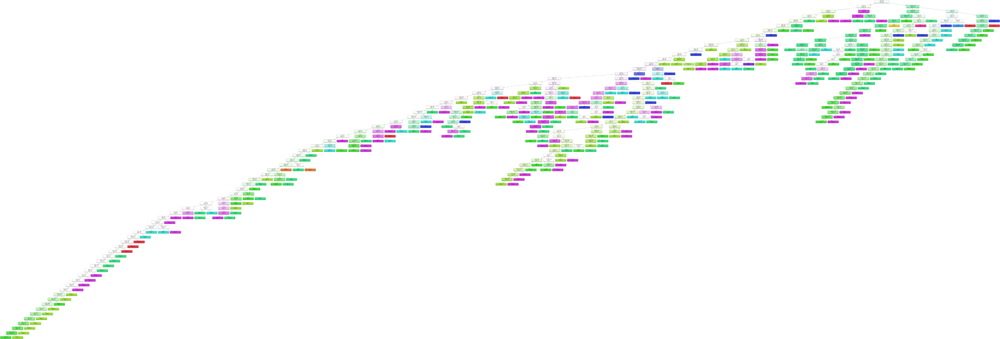

In [332]:
dot_data = tree.export_graphviz(clf, out_file=None, 
                         feature_names=palabrasUnicasVector,
                         filled=True, rounded=True,  
                         special_characters=True)  
graph = graphviz.Source(dot_data)  
graph

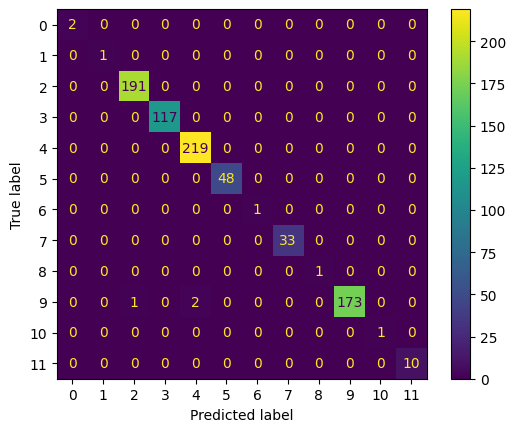

In [333]:
from sklearn.metrics import confusion_matrix, f1_score, roc_curve, precision_score, recall_score, accuracy_score, roc_auc_score
from sklearn import metrics
y_predict = clf.predict(X_train)
cm = confusion_matrix(y_train, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              
                             )
disp.plot()


In [334]:
print(metrics.classification_report(y_train,y_predict, digits = 4))

                                precision    recall  f1-score   support

          Ciencia y Tecnología     1.0000    1.0000    1.0000         2
                       Comedia     1.0000    1.0000    1.0000         1
                      Deportes     0.9948    1.0000    0.9974       191
                     Educación     1.0000    1.0000    1.0000       117
               Entretenimiento     0.9910    1.0000    0.9955       219
                 Gente y Blogs     1.0000    1.0000    1.0000        48
           Mascotas y Animales     1.0000    1.0000    1.0000         1
                        Música     1.0000    1.0000    1.0000        33
           Noticias y Política     1.0000    1.0000    1.0000         1
          Película y Animación     1.0000    0.9830    0.9914       176
Sin fines de lucro y Activismo     1.0000    1.0000    1.0000         1
              Viajes y Eventos     1.0000    1.0000    1.0000        10

                      accuracy                         0.9962 

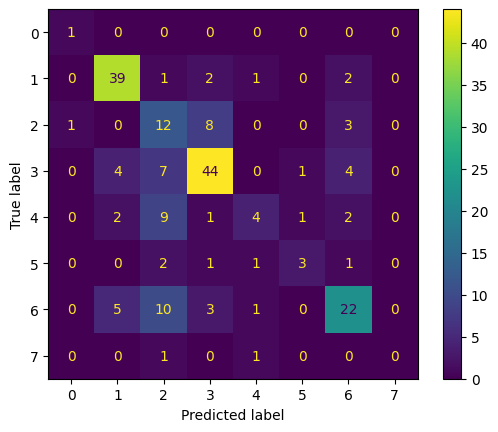

In [335]:
y_predict= clf.predict(X_test)
cm = confusion_matrix(y_test, clf.predict(X_test))
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             )
disp.plot()

In [336]:
print(metrics.classification_report(y_test,y_predict, digits = 4))

                      precision    recall  f1-score   support

Ciencia y Tecnología     0.5000    1.0000    0.6667         1
            Deportes     0.7800    0.8667    0.8211        45
           Educación     0.2857    0.5000    0.3636        24
     Entretenimiento     0.7458    0.7333    0.7395        60
       Gente y Blogs     0.5000    0.2105    0.2963        19
              Música     0.6000    0.3750    0.4615         8
Película y Animación     0.6471    0.5366    0.5867        41
    Viajes y Eventos     0.0000    0.0000    0.0000         2

            accuracy                         0.6250       200
           macro avg     0.5073    0.5278    0.4919       200
        weighted avg     0.6402    0.6250    0.6204       200



C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: U

## Usando Random forest

In [337]:
rf = RandomForestClassifier(n_estimators=3)
rf.fit(X, y)

RandomForestClassifier(n_estimators=3)

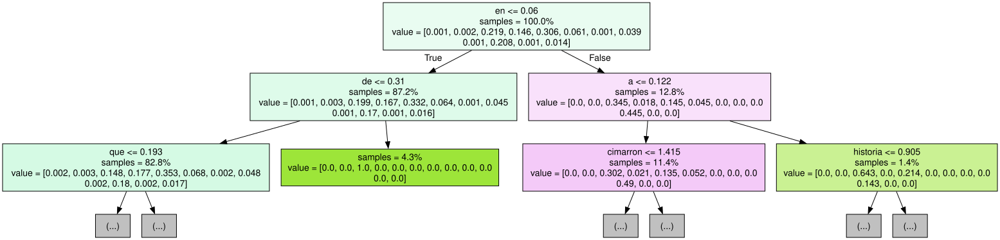

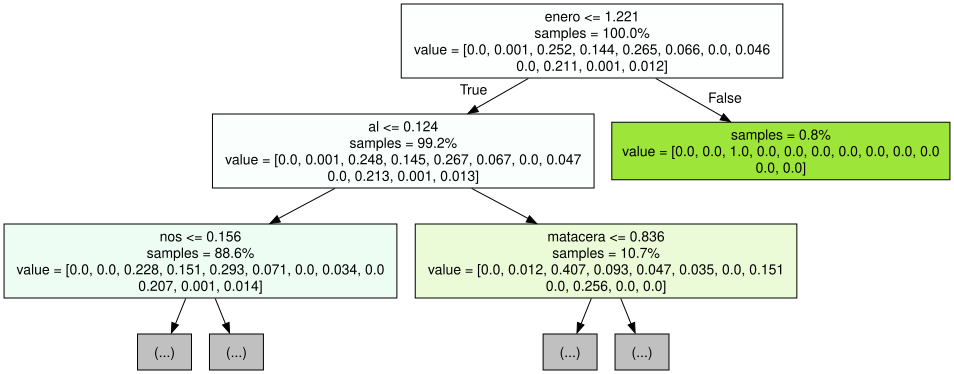

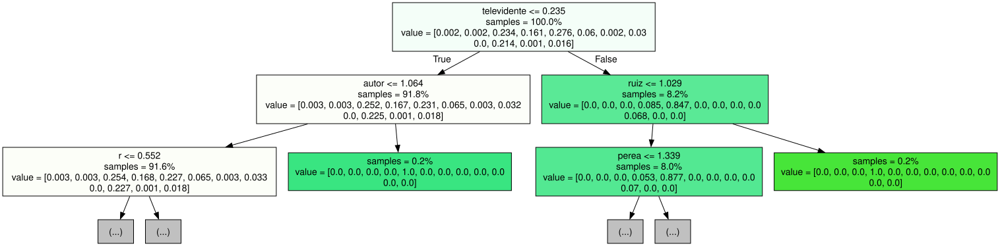

In [338]:
import graphviz
from sklearn.tree import export_graphviz



for i in range(3):
    tree = rf.estimators_[i]
    dot_data = export_graphviz(tree,
                               feature_names=X.columns,  
                               filled=True,  
                               max_depth=2, 
                               impurity=False, 
                               proportion=True)
    graph = graphviz.Source(dot_data)
    display(graph)

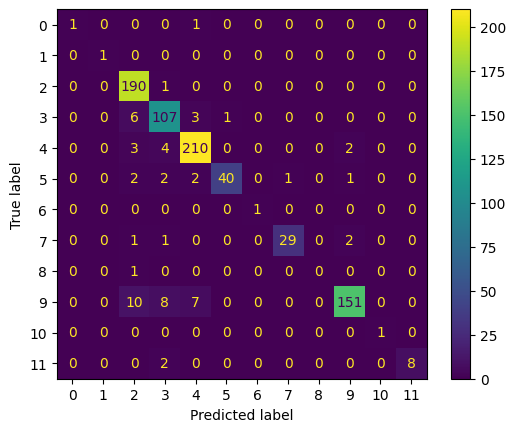

In [339]:
y_predict=rf.predict(X_train)
cm = confusion_matrix(y_train, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             )
disp.plot()

In [340]:
print(metrics.classification_report(y_train,y_predict, digits = 4))

                                precision    recall  f1-score   support

          Ciencia y Tecnología     1.0000    0.5000    0.6667         2
                       Comedia     1.0000    1.0000    1.0000         1
                      Deportes     0.8920    0.9948    0.9406       191
                     Educación     0.8560    0.9145    0.8843       117
               Entretenimiento     0.9417    0.9589    0.9502       219
                 Gente y Blogs     0.9756    0.8333    0.8989        48
           Mascotas y Animales     1.0000    1.0000    1.0000         1
                        Música     0.9667    0.8788    0.9206        33
           Noticias y Política     0.0000    0.0000    0.0000         1
          Película y Animación     0.9679    0.8580    0.9096       176
Sin fines de lucro y Activismo     1.0000    1.0000    1.0000         1
              Viajes y Eventos     1.0000    0.8000    0.8889        10

                      accuracy                         0.9237 

C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: U

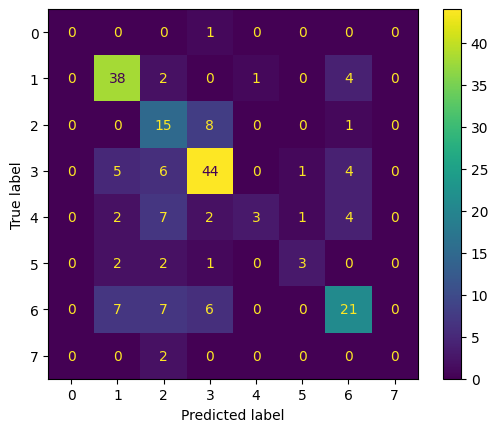

In [341]:
y_predict = rf.predict(X_test)
cm = confusion_matrix(y_test, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             )
disp.plot()

In [342]:
print(metrics.classification_report(y_test,y_predict, digits = 4))

                      precision    recall  f1-score   support

Ciencia y Tecnología     0.0000    0.0000    0.0000         1
            Deportes     0.7037    0.8444    0.7677        45
           Educación     0.3659    0.6250    0.4615        24
     Entretenimiento     0.7097    0.7333    0.7213        60
       Gente y Blogs     0.7500    0.1579    0.2609        19
              Música     0.6000    0.3750    0.4615         8
Película y Animación     0.6176    0.5122    0.5600        41
    Viajes y Eventos     0.0000    0.0000    0.0000         2

            accuracy                         0.6200       200
           macro avg     0.4684    0.4060    0.4041       200
        weighted avg     0.6370    0.6200    0.6025       200



C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\metrics\_classification.py:1344: U

## Usando GBM

In [343]:
from sklearn.ensemble import GradientBoostingClassifier
gbm = GradientBoostingClassifier(n_estimators=3,
                                 learning_rate=1.0,max_depth=3, random_state=0)
gbm.fit(X, y)

GradientBoostingClassifier(learning_rate=1.0, n_estimators=3, random_state=0)

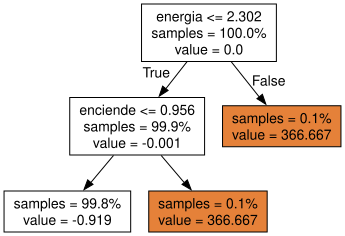

In [344]:
tree = gbm.estimators_[0][0]
dot_data = export_graphviz(tree,
                           feature_names=palabrasUnicasVector,  
                           filled=True,  
                           max_depth=3, 
                           impurity=False, 
                           proportion=True)
graph = graphviz.Source(dot_data)
display(graph)

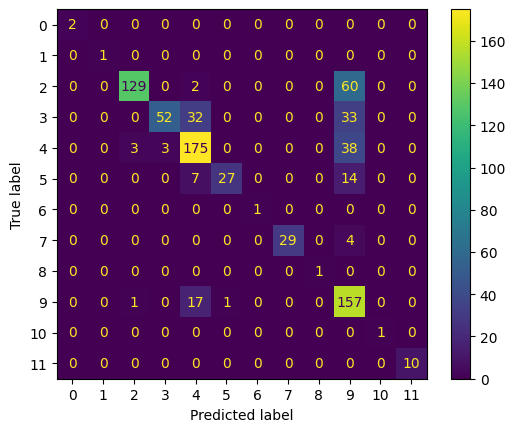

In [345]:
y_predict= gbm.predict(X_train)
cm = confusion_matrix(y_train, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             )
disp.plot()

In [346]:
print(metrics.classification_report(y_train,y_predict, digits = 4))

                                precision    recall  f1-score   support

          Ciencia y Tecnología     1.0000    1.0000    1.0000         2
                       Comedia     1.0000    1.0000    1.0000         1
                      Deportes     0.9699    0.6754    0.7963       191
                     Educación     0.9455    0.4444    0.6047       117
               Entretenimiento     0.7511    0.7991    0.7743       219
                 Gente y Blogs     0.9643    0.5625    0.7105        48
           Mascotas y Animales     1.0000    1.0000    1.0000         1
                        Música     1.0000    0.8788    0.9355        33
           Noticias y Política     1.0000    1.0000    1.0000         1
          Película y Animación     0.5131    0.8920    0.6515       176
Sin fines de lucro y Activismo     1.0000    1.0000    1.0000         1
              Viajes y Eventos     1.0000    1.0000    1.0000        10

                      accuracy                         0.7312 

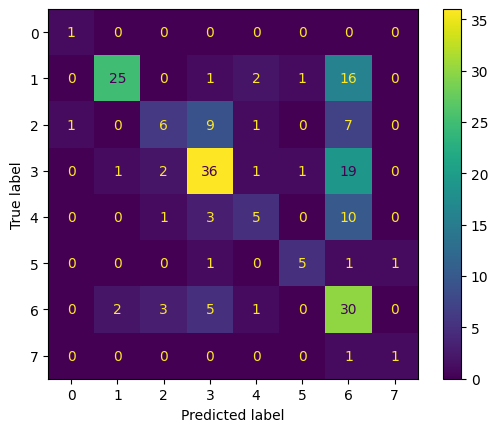

In [347]:
y_predict=gbm.predict(X_test)
cm = confusion_matrix(y_test, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             )
disp.plot()

In [348]:
print(metrics.classification_report(y_test,y_predict, digits = 4))

                      precision    recall  f1-score   support

Ciencia y Tecnología     0.5000    1.0000    0.6667         1
            Deportes     0.8929    0.5556    0.6849        45
           Educación     0.5000    0.2500    0.3333        24
     Entretenimiento     0.6545    0.6000    0.6261        60
       Gente y Blogs     0.5000    0.2632    0.3448        19
              Música     0.7143    0.6250    0.6667         8
Película y Animación     0.3571    0.7317    0.4800        41
    Viajes y Eventos     0.5000    0.5000    0.5000         2

            accuracy                         0.5450       200
           macro avg     0.5774    0.5657    0.5378       200
        weighted avg     0.6140    0.5450    0.5481       200

